<a href="https://colab.research.google.com/github/bk62/deep-learning-notebooks/blob/main/fast_ai/01_Big_Cats_Classifier_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install duckduckgo_search

from duckduckgo_search import ddg_images

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 62 kB 1.7 MB/s 
     |████████████████████████████████| 96 kB 7.0 MB/s 
  Attempting uninstall: requests
    Found existing installation: requests 2.23.0
    Uninstalling requests-2.23.0:
      Successfully uninstalled requests-2.23.0
  Attempting uninstall: click
    Found existing installation: click 7.1.2
    Uninstalling click-7.1.2:
      Successfully uninstalled click-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flask 1.1.4 requires click<8.0,>=5.1, but you have click 8.1.3 which is incompatible.


In [4]:
from fastcore.all import *
from fastdownload import download_url
from fastai.vision.all import *
from time import sleep

def search_images(term, max_images=100):
  return L(ddg_images(term, max_results=max_images)).itemgot('image')

In [5]:
def store_search_images_in_path(searches, path, extra_term=""):
  path = Path(path)
  for o in searches:
    dest = (path / o)
    dest.mkdir(exist_ok=True, parents=True)
    q = f"{o} {extra_term}" if extra_term else q
    download_images(dest, urls=search_images(f"{q} photo"))
    sleep(10)
    download_images(dest, urls=search_images(f"{q} sun photo"))
    sleep(10)
    download_images(dest, urls=search_images(f"{q} shade photo"))
    sleep(10)
    resize_images(path/o, max_size=400, dest=path/o)
  
  failed = verify_images(get_image_files(path))
  failed.map(Path.unlink)
  print(f"Deleted {len(failed)} downloads")

# Adult Big Cats


## Download images

Mounting Google drive on Google Collab for persistent downloaded image storage.

In [6]:
!mkdir drive/MyDrive/adult_big_cats

mkdir: cannot create directory ‘drive/MyDrive/adult_big_cats’: File exists


In [7]:
root_path = Path("drive") / "MyDrive"
adult_big_cats_path = root_path / "adult_big_cats"

big_cats = (
    "lion", "tiger", "jaguar", "leopard", "snow leopard", "cheetah", "cougar"
)

In [ ]:
# Run to download images when running for the first time

store_search_images_in_path(big_cats, adult_big_cats_path, "adult animal")

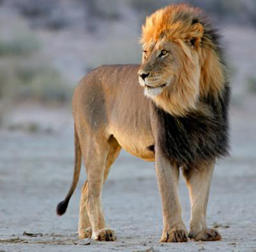

In [8]:
im = Image.open(adult_big_cats_path / "lion/00287410-4e01-480c-8be5-87cb9bffd2ba.jpg")
im.to_thumb(256, 256)

## Cleaning up by removing irrelevant examples

We need to get rid of any images that are not actually big cats e.g. people in costumes, examples of leopard print fabric etc.

On google colab with mounted google drive, this is easier to do by using [drive.google.com](https://drive.google.com).

In [62]:
from fastai.vision.widgets import ImagesCleaner

fns = get_image_files(adult_big_cats_path / "lion/")
cleaner = ImagesCleaner(max_n=4)
cleaner.set_fns(fns)
cleaner

Box(children=(VBox(children=(Output(layout=Layout(height='128px')), Dropdown(layout=Layout(width='max-content'…

In [ ]:
for idx in cleaner.delete():
  cleaner.fns[idx].unlink()


## Train Models


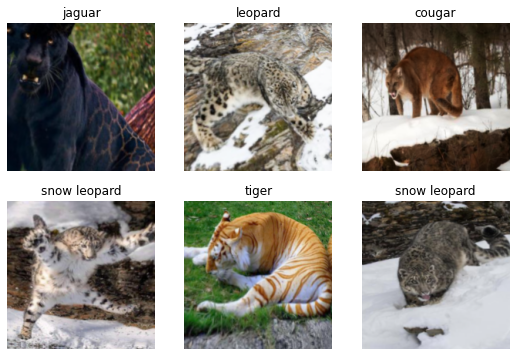

In [9]:
adls = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=RandomResizedCrop(192, min_scale=0.5),
    batch_tfms=aug_transforms()
).dataloaders(adult_big_cats_path)

adls.show_batch(max_n=6)

In [10]:
alearn = vision_learner(adls, resnet18, metrics=error_rate)
alearn.fine_tune(4)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

epoch,train_loss,valid_loss,error_rate,time
0,1.999318,0.849498,0.215976,06:56


epoch,train_loss,valid_loss,error_rate,time
0,0.825313,0.554874,0.165680,00:09
1,0.764230,0.651644,0.177515,00:09
2,0.653723,0.572998,0.189349,00:08
3,0.554099,0.553967,0.198225,00:10


## Analyze Initial Results

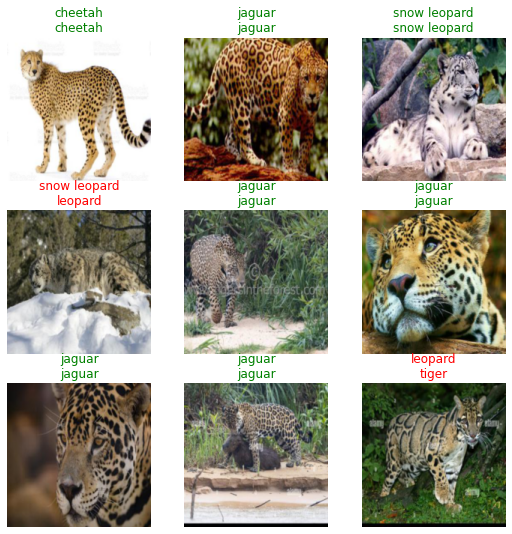

In [11]:
alearn.show_results()

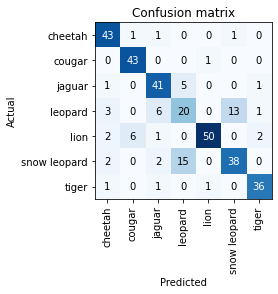

In [12]:
interp = ClassificationInterpretation.from_learner(alearn)
interp.plot_confusion_matrix()

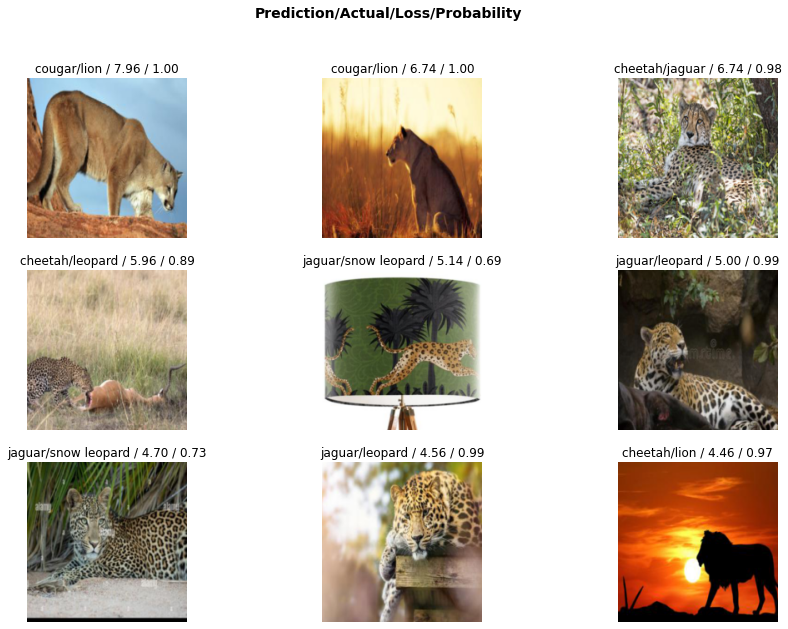

In [13]:
interp.plot_top_losses(9, figsize=(15,10))

## Cleaning up dataset again

In [14]:
from fastai.vision.widgets import ImageClassifierCleaner

cleaner = ImageClassifierCleaner(alearn)
cleaner

In [15]:
for idx in cleaner.delete():
  cleaner.fns[idx].unlink()

for idx,cat in cleaner.change():
  shutil.move(str(cleaner.fns[idx]), adult_big_cats_path/cat)

## Retraining Model

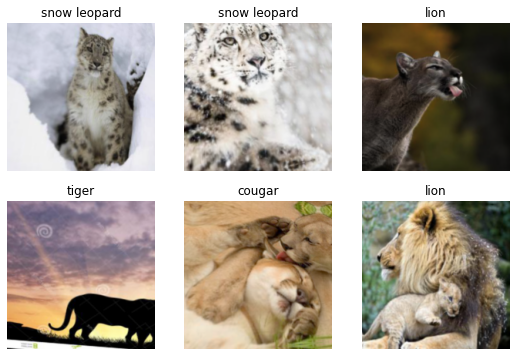

In [16]:
adls = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=RandomResizedCrop(192, min_scale=0.5),
    batch_tfms=aug_transforms()
).dataloaders(adult_big_cats_path)

adls.show_batch(max_n=6)

In [17]:
alearn = vision_learner(adls, resnet18, metrics=error_rate)
alearn.fine_tune(4)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,error_rate,time
0,1.981069,0.927279,0.224852,00:10


epoch,train_loss,valid_loss,error_rate,time
0,0.822142,0.690563,0.201183,00:09
1,0.722757,0.683218,0.189349,00:13
2,0.597633,0.628151,0.168639,00:09
3,0.531196,0.625989,0.174556,00:09


## Final results

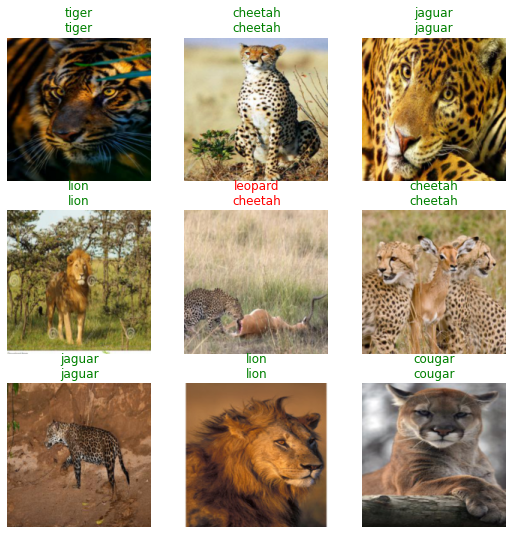

In [18]:
alearn.show_results()

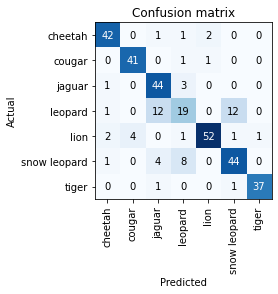

In [19]:
interp = ClassificationInterpretation.from_learner(alearn)
interp.plot_confusion_matrix()

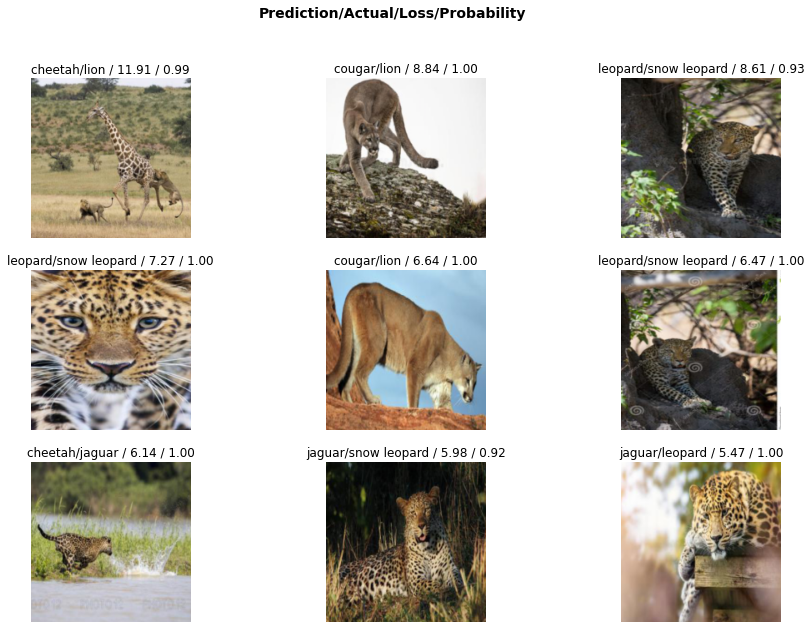

In [20]:
interp.plot_top_losses(9, figsize=(15,10))